## 앞에서 익힌 방법을 이용해서 연도별(2017~2020) 4장의 히트맵 이미지 파일을 만들어 봅시다

## 관련 패키지 불러오기

In [1]:
import pandas as pd
import geopandas as gpd

c:\Users\LX\AppData\Local\Programs\Python\Python39\lib\site-packages\geopandas\_compat.py:124: UserWarning: The Shapely GEOS version (3.11.1-CAPI-1.17.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(
C:\Users\LX\AppData\Local\Temp\ipykernel_12556\1259499560.py:2: DeprecationWarning: Shapely 2.0 is installed, but because PyGEOS is also installed, GeoPandas still uses PyGEOS by default. However, starting with version 0.14, the default will switch to Shapely. To force to use Shapely 2.0 now, you can either uninstall PyGEOS or set the environment variable USE_PYGEOS=0. You can do this before starting the Python process, or in your code before importing geopandas:

import os
os.environ['USE_PYGEOS'] = '0'
import geopandas

In the next release, GeoPandas will switch to using Shapely by default, even if PyGEOS is installed. If you only have PyGEOS installed to get speed-ups, this switch should be sm

In [2]:
#import matplotlib
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
sns.set_style('darkgrid') #whitegrid, dark, white, ticks
mpl.rc('font', family='Malgun Gothic') #한글 폰트 적용시
plt.rcParams["figure.figsize"] = (10,10) #차트 사이즈

In [3]:
#import mapclassify as mc
import contextily as ctx  #conda install contextily 또는 pip install contextily

## 데이터

### CCTV 포인트 공간데이터

In [4]:
# shp 로딩
gdf_cctv = gpd.read_file('data/shp/gdf_cctv_sl03.shp', encoding='utf-8')  #euc-kr, euckr, utf-8, cp949 중 선택
gdf_cctv.crs  #좌표계 확인용 

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [5]:
# Dataframe you want to plot
gdf_cctv3857 = gdf_cctv.to_crs(epsg=3857) # reproject it in Web mercator
# Geometry를 이용하여 X, Y 좌표 항목을 생성 
gdf_cctv3857["x"] = gdf_cctv3857.geometry.x
gdf_cctv3857["y"] = gdf_cctv3857.geometry.y
gdf_cctv3857.head(3)

,admin_nm,addr_rd,addr_jb,purpose,cctv_cnt,pixel,direction,period,date_insta,tel,...,date_make,offer_admi,offer_ad_1,sl,zscore_lon,outliers,zscore_lat,geometry,x,y
0,서울특별시 영등포구,"선유로13길 25,서울영문초등학교 사거리앞",선유로13길 25,생활방범,3,None,360도 전방면,30,2018-08,02-2670-4067,...,2020-05-06,3180000,서울특별시 영등포구,0,-1.348028,0,-0.950876,POINT (14124991.821 4511747.327),1.412499e+07,4.511747e+06
1,서울특별시 영등포구,"문래로4길 4,현대2차APT 202동 옆 서부간선도로 사잇길 육교앞",문래로4길 4,생활방범,2,None,360도 전방면,30,2018-08,02-2670-4067,...,2020-05-06,3180000,서울특별시 영등포구,0,-1.406838,0,-0.937394,POINT (14124451.882 4511863.040),1.412445e+07,4.511863e+06
2,서울특별시 영등포구,"선유로9나길 22,사거리앞",문래동5가 12 사거리앞,생활방범,3,None,360도 전방면,30,2018-08,02-2670-4067,...,2020-05-06,3180000,서울특별시 영등포구,0,-1.358297,0,-1.007738,POINT (14124897.547 4511259.295),1.412490e+07,4.511259e+06


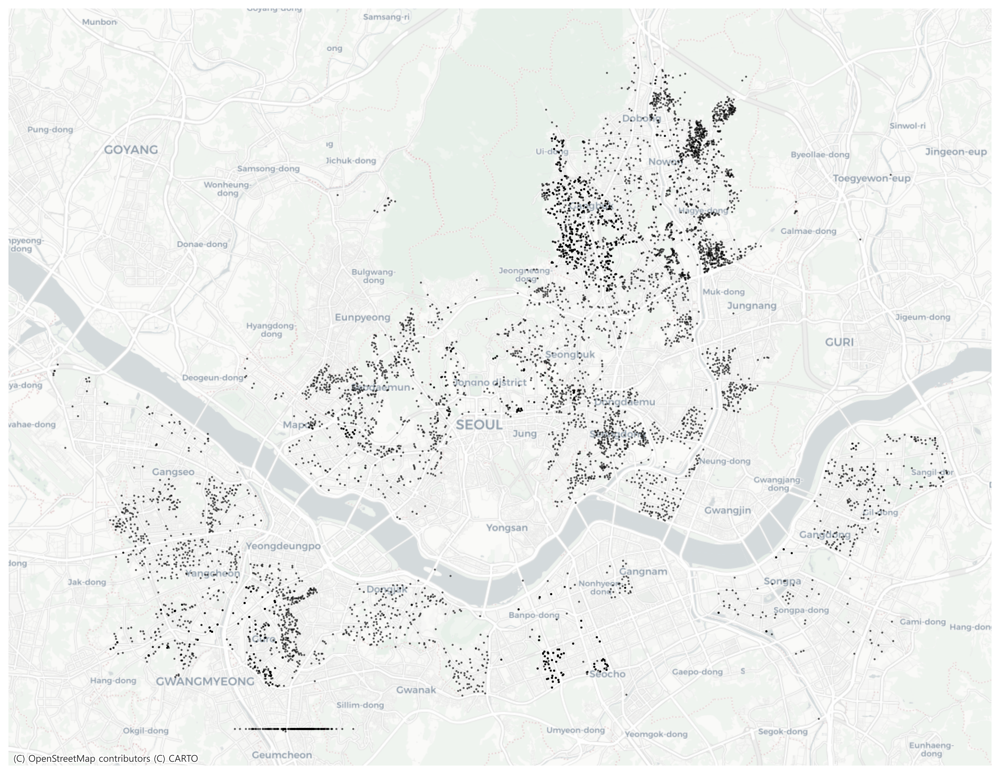

In [6]:
ax = gdf_cctv3857.plot(figsize=(15, 15), color='black', alpha=0.5, markersize=0.7)
# 배경지도 적용
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)
ax.set_axis_off()
plt.show()

### 배경맵
https://contextily.readthedocs.io/en/latest/providers_deepdive.html  

http://maps.stamen.com/#toner/13/37.5500/126.9996

## Seaborn

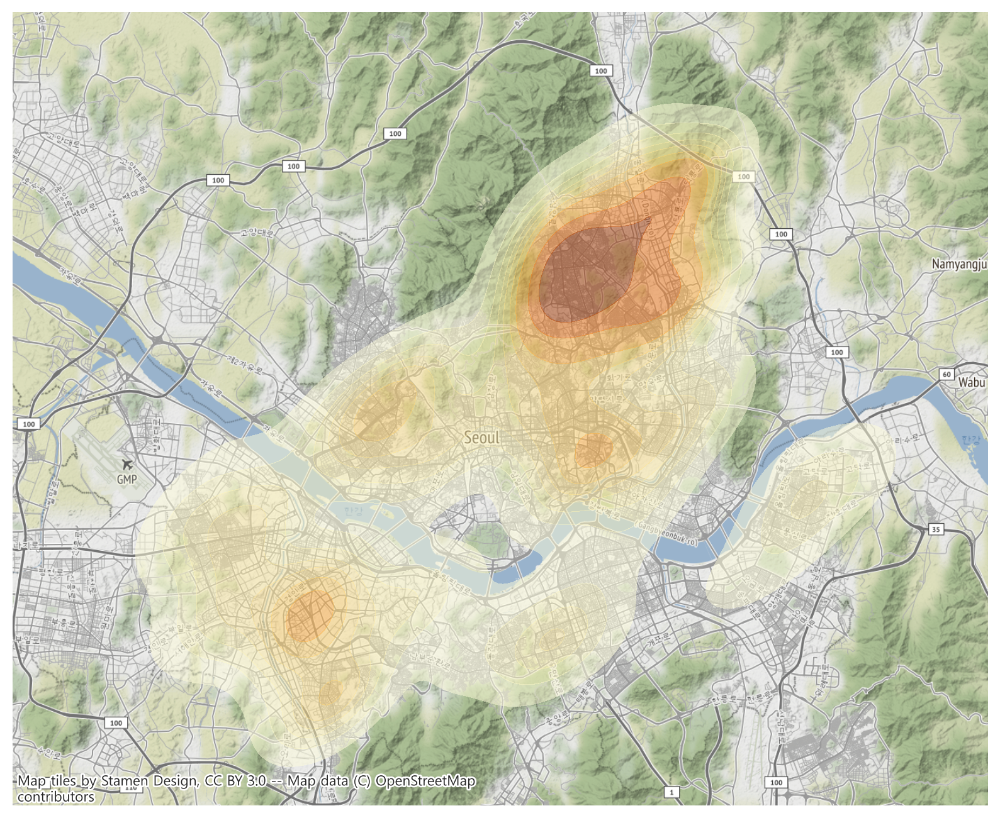

In [7]:
#Seaborn을 이용한 지리적 히트맵 
ax = sns.kdeplot(data=gdf_cctv3857, x=gdf_cctv3857["x"], y=gdf_cctv3857["y"], fill=True, cmap="YlOrBr", alpha=0.5)
ctx.add_basemap(ax, url=ctx.providers.CartoDB.DarkMatter)
ax.set_axis_off()
plt.show()

https://seaborn.pydata.org/generated/seaborn.kdeplot.html

https://seaborn.pydata.org/tutorial/color_palettes.html?highlight=colormap

### Geoplot을 이용해서도 Heatmap을 표현할 수 있습니다.
https://residentmario.github.io/geoplot/gallery/plot_nyc_collision_factors.html  
https://residentmario.github.io/geoplot/gallery/plot_boston_airbnb_kde.html  

## Animation Heatmap
연도별로 CCTV가 주로 설치된 지역을 시각화해보자 

#### 연도 전처리

In [8]:
gdf_cctv3857['date_insta'] = gdf_cctv3857['date_insta'].str.replace(pat='Mar-16', repl= '2016-03', regex=True)
gdf_cctv3857['date_insta'] = gdf_cctv3857['date_insta'].str.replace(pat='Aug-16', repl= '2016-08', regex=True)
gdf_cctv3857['date_insta'] = gdf_cctv3857['date_insta'].str.replace(pat='May-16', repl= '2016-05', regex=True)
gdf_cctv3857['date_insta'] = gdf_cctv3857['date_insta'].str.replace(pat='Jun-16', repl= '2016-06', regex=True)
gdf_cctv3857['date_insta'] = gdf_cctv3857['date_insta'].str.replace(pat='Oct-16', repl= '2016-10', regex=True)

In [9]:
# 설치년도가 없는 데이터 삭제
gdf_cctv3857.dropna(subset=['date_insta'],axis=0,inplace=True)

In [10]:
gdf_cctv3857['year'] = gdf_cctv3857['date_insta'].str[:4] #앞 4자리 문자열만 추출

In [11]:
# 연도 항목을 정수형으로 변환
gdf_cctv3857['year2'] = gdf_cctv3857['year'].astype(int)

## 연도별 kdeplot 이미지 저장   
image 폴더 아래에 heatmap이라는 폴더를 미리 만들어 주세요~  

### Seaborn의 kdeplot 응용  
https://seaborn.pydata.org/generated/seaborn.kdeplot.html  

# 노트북이 실행되는 폴더 내에 image/heatmap 폴더를 만들어 주세요~~~~

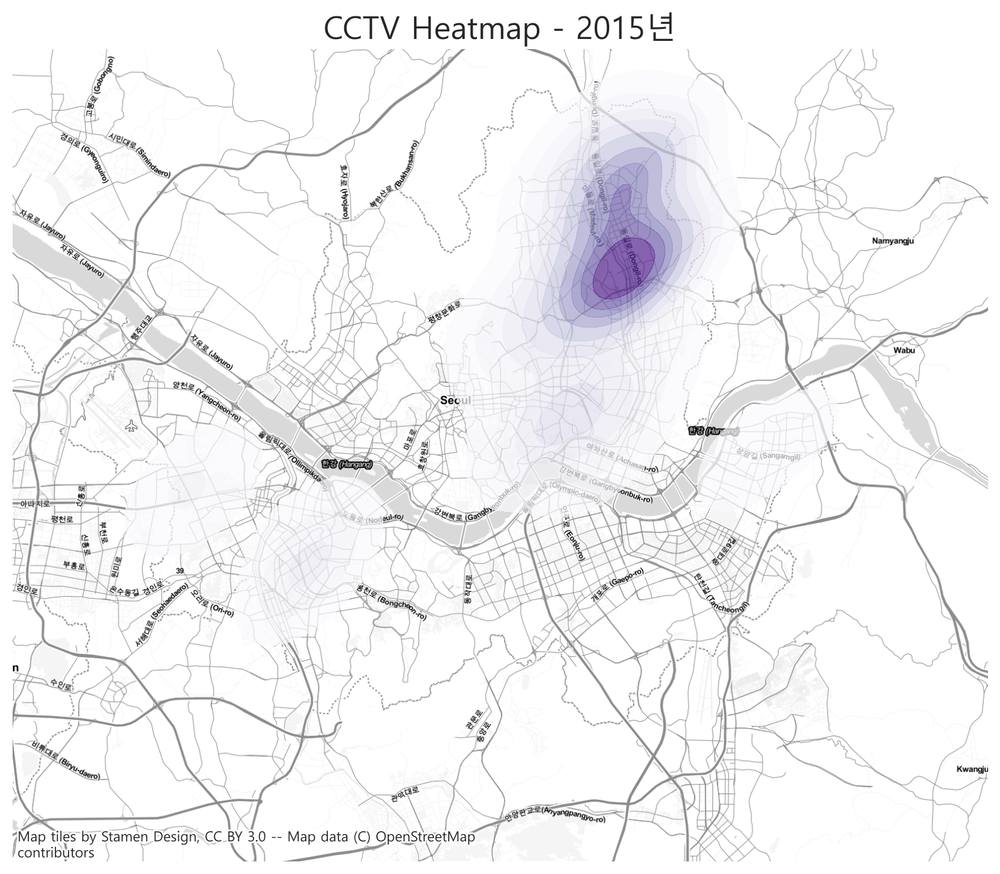

In [19]:
# 2015년 
# lvl = ctx.Place('Seoul', url=ctx.providers.Stamen.ST_TONER_LITE)
lvl = ctx.Place('Seoul', source=ctx.providers.Stamen.TonerLite)
ax = sns.kdeplot(data=gdf_cctv3857[gdf_cctv3857['year2'] == 2015], x="x", y="y", cmap='Purples', alpha=0.7, fill=True)
lvl.plot(ax)
ax.set_axis_off()
plt.title('CCTV Heatmap - 2015년', fontsize=18)
#fig = plt.gcf()
plt.savefig("./image/heatmap/heatmap_2015.png", bbox_inches='tight', pad_inches=0.01)
plt.show()

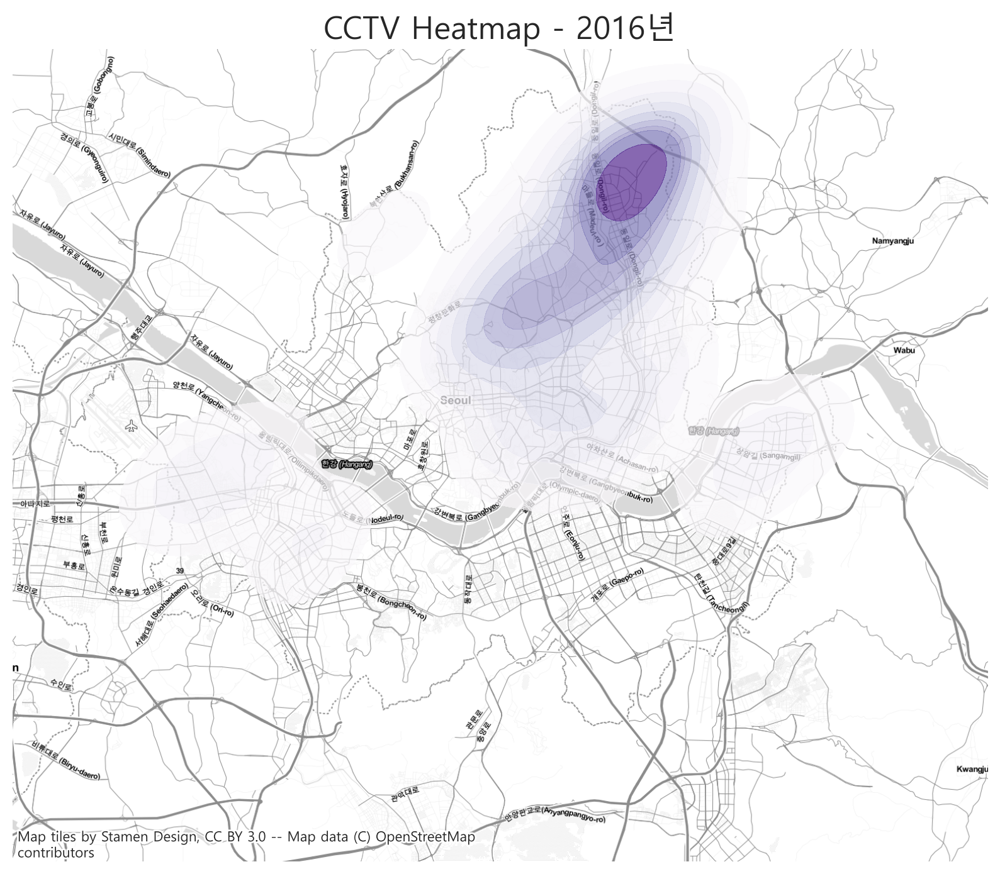

In [20]:
# 2016년 
lvl = ctx.Place('Seoul', source=ctx.providers.Stamen.TonerLite)
ax = sns.kdeplot(data=gdf_cctv3857[gdf_cctv3857['year2'] == 2016], x="x", y="y", cmap='Purples', alpha=0.7, fill=True)
lvl.plot(ax)
ax.set_axis_off()
plt.title('CCTV Heatmap - 2016년', fontsize=18)
plt.savefig("./image/heatmap/heatmap_2016.png", bbox_inches='tight', pad_inches=0.01)

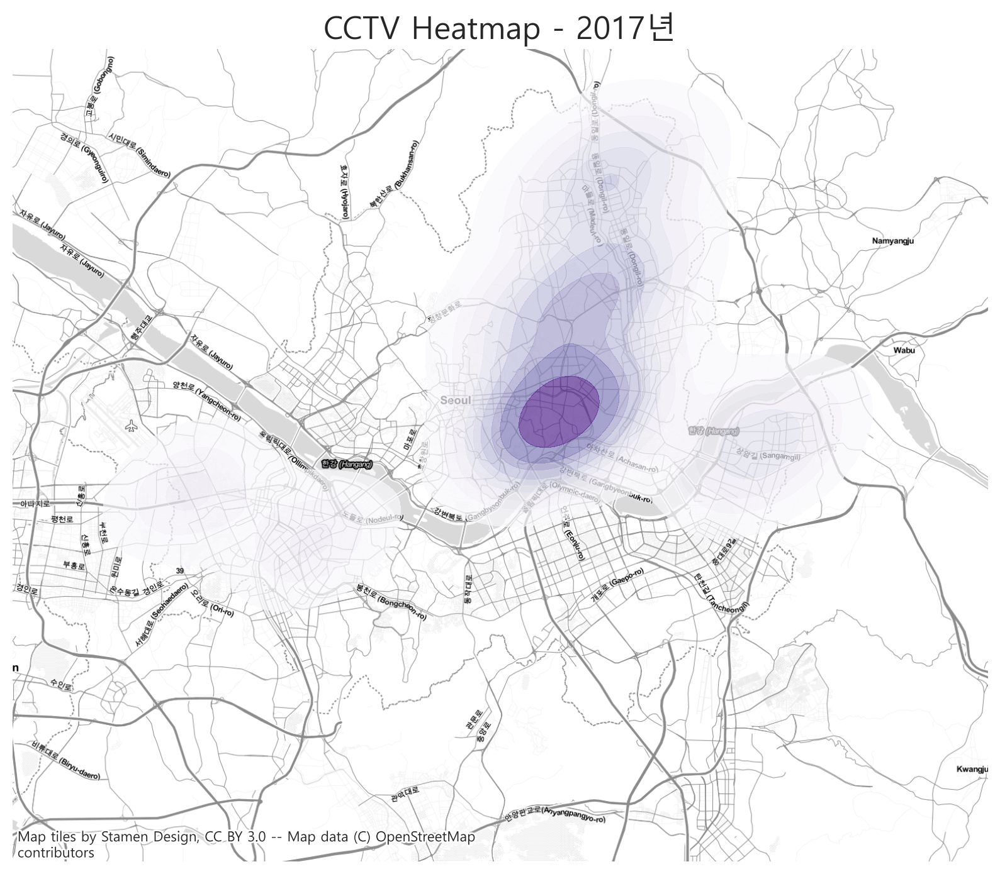

In [21]:
# 2017년 
lvl = ctx.Place('Seoul', source=ctx.providers.Stamen.TonerLite)
ax = sns.kdeplot(data=gdf_cctv3857[gdf_cctv3857['year2'] == 2017], x="x", y="y", cmap='Purples', alpha=0.7, fill=True)
lvl.plot(ax)
ax.set_axis_off()
plt.title('CCTV Heatmap - 2017년', fontsize=18)
plt.savefig("./image/heatmap/heatmap_2017.png", bbox_inches='tight', pad_inches=0.01)

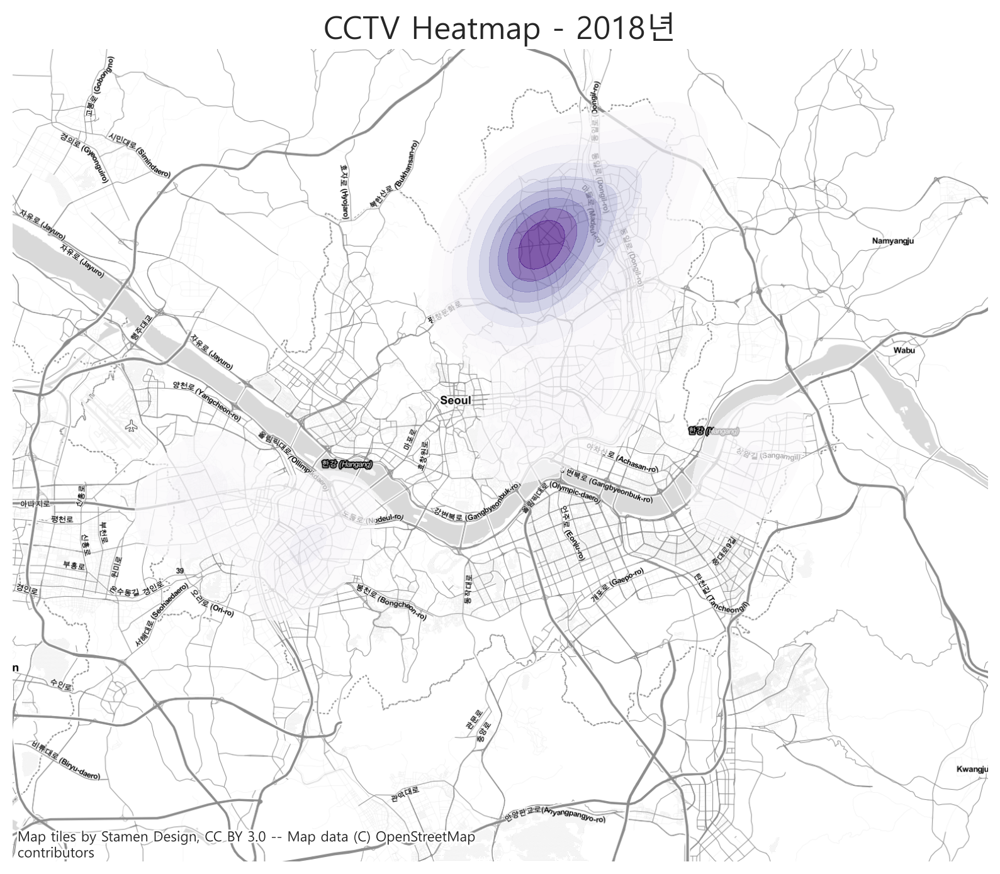

In [22]:
# 2018년 
lvl = ctx.Place('Seoul', source=ctx.providers.Stamen.TonerLite)
ax = sns.kdeplot(data=gdf_cctv3857[gdf_cctv3857['year2'] == 2018], x="x", y="y", cmap='Purples', alpha=0.7, fill=True)
lvl.plot(ax)
ax.set_axis_off()
plt.title('CCTV Heatmap - 2018년', fontsize=18)
plt.savefig("./image/heatmap/heatmap_2018.png", bbox_inches='tight', pad_inches=0.01)

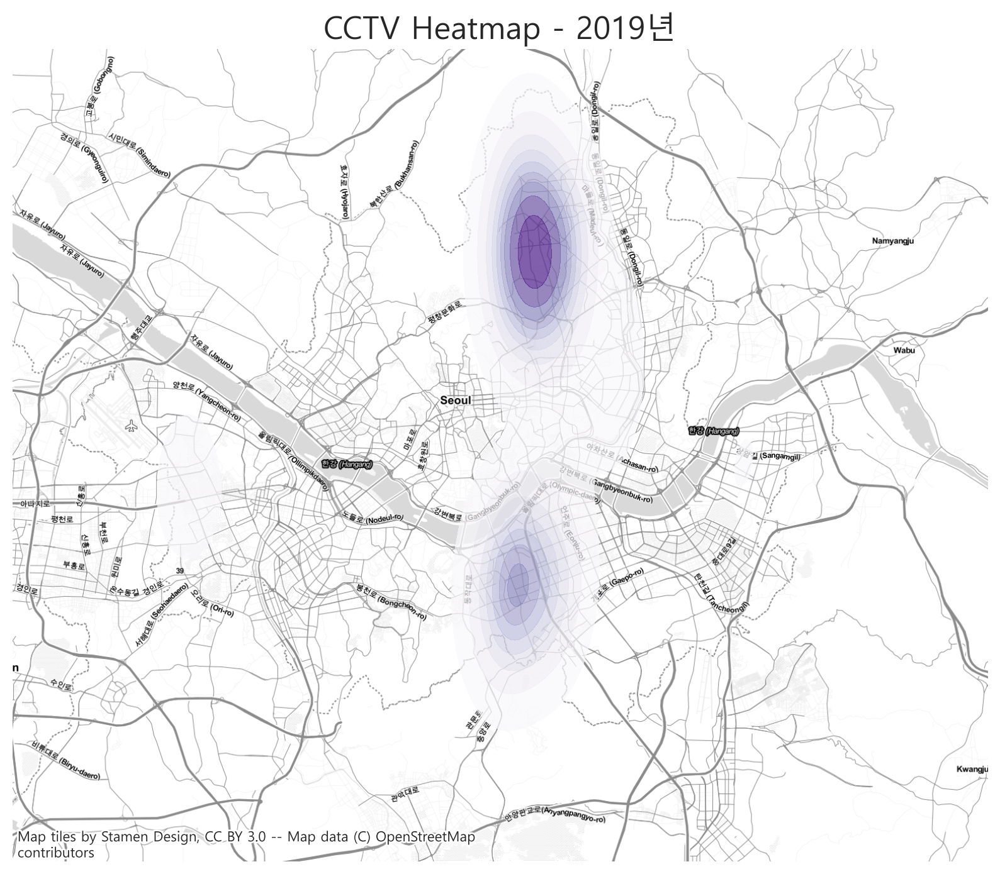

In [23]:
# 2019년 
lvl = ctx.Place('Seoul', source=ctx.providers.Stamen.TonerLite)
ax = sns.kdeplot(data=gdf_cctv3857[gdf_cctv3857['year2'] == 2019], x="x", y="y", cmap='Purples', alpha=0.7, fill=True)
lvl.plot(ax)
ax.set_axis_off()
plt.title('CCTV Heatmap - 2019년', fontsize=18)
plt.savefig("./image/heatmap/heatmap_2019.png", bbox_inches='tight', pad_inches=0.01)

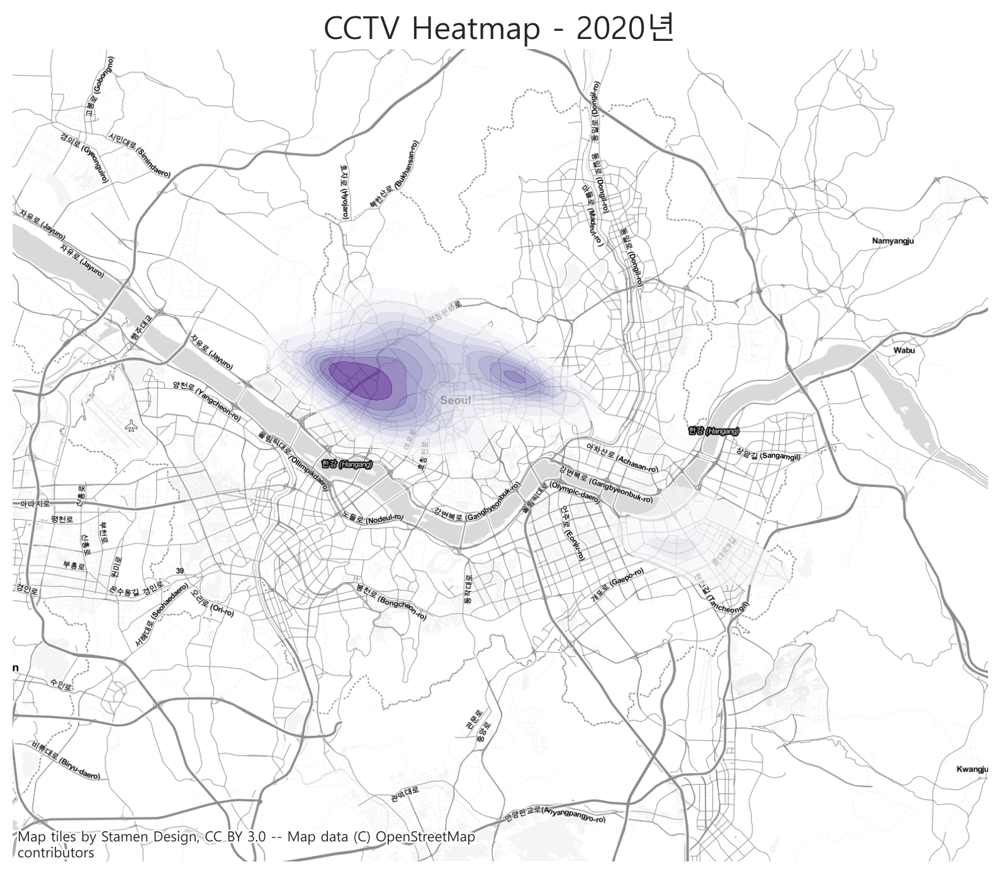

In [24]:
# 2020년 
lvl = ctx.Place('Seoul', source=ctx.providers.Stamen.TonerLite)
ax = sns.kdeplot(data=gdf_cctv3857[gdf_cctv3857['year2'] == 2020], x="x", y="y", cmap='Purples', alpha=0.7, fill=True)
lvl.plot(ax)
ax.set_axis_off()
plt.title('CCTV Heatmap - 2020년', fontsize=18)
plt.savefig("./image/heatmap/heatmap_2020.png", bbox_inches='tight', pad_inches=0.01)

#### 만들어진 연도별 이미지 파일들을 GIF로 생성

In [ ]:
# !pip install imageio

In [27]:
from pathlib import Path
import imageio    #!pip install imageio

In [28]:
image_path = Path('./image/heatmap') #특정 폴더/경로 지정
images = list(image_path.glob('*.png'))  #해당 경로의 특정 포맷에 대한 (이미지) 파일명 리스트 생성
image_list = []   
for file_name in images:  #Animated GIF 생성용 리스트에 추가
    image_list.append(imageio.imread(file_name))

C:\Users\LX\AppData\Local\Temp\ipykernel_12556\2306931687.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image_list.append(imageio.imread(file_name))


In [34]:
# Animated GIF 생성 
imageio.mimwrite('./image/heatmap/cctv_heatmap.gif', image_list, duration=0.1, loop=True ) 
#fps는 초 단위 --> duration으로 파라미터명을 수정해 주십시오~~